In [1]:
import pandas as pd
import numpy as np
import yt
import ShapeTensor as st
import random
import Cat_basic_plots_og as bp

path = r'/vol/sci/astro/bigdata/tussbaum/halofinder/catalog/'

sim_cat     = pd.read_pickle(path + r'/sim_table.pkl')
sim_cat.set_index(['sid'], inplace=True)

cen_gal_cat = pd.read_pickle(path + r'/cen_gal_cat.pkl')



Cat_basic_plots_og.py:2: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

The backend was *originally* set to 'module://ipykernel.pylab.backend_inline' by the following code:
  File "/cs/sci/sharonl/miniconda/envs/iyt34/lib/python2.7/runpy.py", line 174, in _run_module_as_main
    "__main__", fname, loader, pkg_name)
  File "/cs/sci/sharonl/miniconda/envs/iyt34/lib/python2.7/runpy.py", line 72, in _run_code
    exec code in run_globals
  File "/vol/sci/astro/home/adambeilialpha/.local/lib/python2.7/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/cs/sci/adambeilialpha/.local/lib/python2.7/site-packages/traitlets/config/application.py", line 663, in launch_instance
    app.initialize(argv)
  File "<decorator-gen-121>", line 2, in initialize
  File "/cs/sci/adambeil

In [14]:
halo_cat_all_DM = pd.read_pickle(path + r'/halo_cat_all_DM.pkl')
sgal_full_thick_table = pd.read_pickle(path + r'/sgal_full_thick_table.pkl')
sat_gal_table = pd.read_pickle(path + r'/sat_gal_table.pkl')

In [15]:
print len(halo_cat_all_DM), len(sgal_full_thick_table), len(sat_gal_table)

7466 27673 162189


In [16]:
sat_gal_table.head()

,zana_r,zana_z,zana_y,zana_x,zana_n_stars,galaxynumber,sgal_id,sim_id,gen,zana_mass,zana_gid,snap_index,type,aexp
0,0.82456,0.424194,0.506656,0.519202,1548,01,VELA_v2.Thick.01.a0.150007307529_00001,VELA_v2.Thick.01.a0.150007307529,VELA_v2,17400000.0,1,a0.150,Thick,0.150007
1,0.39000,0.479675,0.535324,0.496309,136,01,VELA_v2.Thick.01.a0.150007307529_00002,VELA_v2.Thick.01.a0.150007307529,VELA_v2,1150000.0,2,a0.150,Thick,0.150007
2,0.30567,0.415544,0.465935,0.546558,182,01,VELA_v2.Thick.01.a0.150007307529_00003,VELA_v2.Thick.01.a0.150007307529,VELA_v2,3280000.0,3,a0.150,Thick,0.150007
3,0.77434,0.426821,0.506934,0.518233,1947,01,VELA_v2.Thick.01.a0.160037651658_00001,VELA_v2.Thick.01.a0.160037651658,VELA_v2,19200000.0,1,a0.160,Thick,0.160038
4,1.30089,0.418395,0.467739,0.542792,331,01,VELA_v2.Thick.01.a0.160037651658_00002,VELA_v2.Thick.01.a0.160037651658,VELA_v2,6480000.0,2,a0.160,Thick,0.160038


In [12]:
halo_cat_all.head()

,aexpn,aexp,gen,galaxynumber,type,center[0](code),center[1](code),center[2](code),r_vir[kpc],all_density_profile,all_density_edges
sid,,,,,,,,,,,
VELA_v2.Thick.01.a0.120081201196,0.120081,0.12,VELA_v2,01,Thick,0.521348,0.506132,0.417145,6.75,"[1405777841.89, 753661609.699, 446415022.178, ...","[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, ..."
VELA_v2.Thick.01.a0.130082651973,0.130083,0.13,VELA_v2,01,Thick,0.520908,0.506954,0.419748,8.50,"[1774888537.45, 713037974.367, 447670396.739, ...","[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, ..."
VELA_v2.Thick.01.a0.140073657036,0.140074,0.14,VELA_v2,01,Thick,0.519948,0.505667,0.421386,10.25,"[1719275068.85, 832547110.191, 515503128.527, ...","[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, ..."
VELA_v2.Thick.01.a0.150007307529,0.150007,0.15,VELA_v2,01,Thick,0.519214,0.506668,0.424141,12.25,"[1287626312.81, 889563972.5, 593383207.969, 46...","[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, ..."
VELA_v2.Thick.01.a0.160037651658,0.160038,0.16,VELA_v2,01,Thick,0.518236,0.506951,0.426802,14.25,"[1576007198.91, 772424550.422, 534934449.014, ...","[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, ..."


In [2]:
%%time
sgal_R_df   = pd.read_pickle(path + r'/sgal_R_thick_table.pkl')

CPU times: user 1min 1s, sys: 368 ms, total: 1min 1s
Wall time: 1min 1s


In [8]:
len(sgal_R_df)

27673

In [4]:
sgal_R_df[['zana_r','Reff(Rsb)']]

,zana_r,Reff(Rsb)
sgal_id,,
VELA_v2.Thick.01.a0.150007307529_00001,0.82456,1.09950272925
VELA_v2.Thick.01.a0.150007307529_00002,0.39000,1.02404879667
VELA_v2.Thick.01.a0.150007307529_00003,0.30567,1.42946420069
VELA_v2.Thick.01.a0.160037651658_00001,0.77434,1.42785996498
VELA_v2.Thick.01.a0.160037651658_00002,1.30089,1.20162479019
VELA_v2.Thick.01.a0.170074686408_00001,1.02710,1.28795659056
VELA_v2.Thick.01.a0.170074686408_00002,1.04355,1.20036755817
VELA_v2.Thick.01.a0.180022269487_00001,1.10541,1.43663905587
VELA_v2.Thick.01.a0.180022269487_00002,1.39683,1.20118174406


In [3]:
sgal_R_df.keys().values

array(['zana_r', 'zana_z', 'zana_y', 'zana_x', 'zana_n_stars',
       'galaxynumber', 'sim_id', 'gen', 'zana_mass', 'zana_gid',
       'snap_index', 'type', 'aexp', 'x(kpc)', 'y(kpc)', 'z(kpc)', 'Rcen',
       'rho_th', 'Rth', 'Rsb', 'rho_sb', 'Mstar(Rsb)', 'Mdm(Rsb)',
       'Mgas(Rsb)', 'Mtot(Rsb)', 'sfr(Rsb)', 'ssfr(Rsb)', 'sigma(Rsb)',
       'density(Rsb)', 'f_gas(Rsb)', 't_dep(Rsb)', 'Reff(Rsb)',
       'Mstar(Reff)', 'Mdm(Reff)', 'Mgas(Reff)', 'Mtot(Reff)', 'sfr(Reff)',
       'sigma(Reff)', 'density(Reff)', 'f_gas(Reff)', 't_dep(Reff)',
       'Mstar(1kpc)', 'Mdm(1kpc)', 'Mgas(1kpc)', 'Mtot(1kpc)', 'sfr(1kpc)',
       'sigma(1kpc)', 'density(1kpc)', 'f_gas(1kpc)', 't_dep(1kpc)',
       'Rzana', 'Mstar(Rzana)', 'Mdm(Rzana)', 'Mgas(Rzana)', 'Mtot(Rzana)',
       'sfr(Rzana)', 'sigma(Rzana)', 'density(Rzana)', 'f_gas(Rzana)',
       't_dep(Rzana)', 'ssfr(Reff)', 'ssfr(1kpc)', 'ssfr(Rzana)',
       'Rcen-Rvir', 'Rvir'], dtype=object)

path_1 = r'/vol/sci/astro/home/adambeilialpha/'
#sgal_R_df = pd.read_pickle(path_1 + r'sgal_shape_df_2800.pkl')
sgal_R_df = pd.read_pickle(path + 'sgal_special_attribute_cat.profiles.pkl')

sgal_dm = pd.read_pickle(path_1 + r'/sgal_r_dm_df_2750.pkl')

In [ ]:
tgid = 'VELA_v2.Thick.22_tmp_00004'


'VELA_v2.Thick.22.a0.190173849463_00003'   # 1. entering rvir
'VELA_v2.Thick.22.a0.21007296443_00006'     # 2. compaction and small sSFR decrease
'VELA_v2.Thick.22.a0.240224197507_00004'   # 3. mid sSFR
'VELA_v2.Thick.22.a0.290110230446_00005'   # 4. zero sSFR ~10^-3
'VELA_v2.Thick.22.a0.36011660099_00012'     # 5. after decrease in sigma0.5kpc

In [344]:
sgid = 'VELA_v2.Thick.07.a0.360056459904_00009'

# sgid = 'VELA_v2.Thick.07.a0.360056459904_00002'
#sgid = 'VELA_v2.Thick.01.a0.310190021992_00013' # 3.33573
#sgid = 'VELA_v2.Thick.04.a0.47003158927_00009' # 5.2887
#sgid = 'VELA_v2.Thick.26.a0.420061826706_00004' # 5.19673

#sgid = 'VELA_v2.Thick.10.a0.230110421777_00027' # 1.6821
#sgid = 'VELA_v2.Thick.19.a0.100022621453_00003' # 139.985 32.9853
#sgid = 'VELA_v2.Thick.07.a0.380206227303_00037' # 135.676 -0.0744014
#sgid = 'VELA_v2.Thick.02.a0.460233658552_00003' # 9.7933 -0.706699
#sgid = 'VELA_v2.Thick.14.a0.410276859999_00002' # 86.8289 0.578899        # !!!

#sgid = 'VELA_v2.Thick.07.a0.360056459904_00002'; #per_thresh=1.01; consistency=8; min_bin_dis=25
#sgid = 'VELA_v2.Thick.10.a0.230110421777_00027'; #per_thresh=1.01; consistency=8; min_bin_dis=25
#sgid = 'VELA_v2.Thick.19.a0.100022621453_00003'; #per_thresh=1.01; consistency=8; min_bin_dis=25
#sgid = 'VELA_v2.Thick.07.a0.380206227303_00037'; #per_thresh=1.01; consistency=8; min_bin_dis=25
#sgid = 'VELA_v2.Thick.02.a0.460233658552_00003'; #per_thresh=1.01; consistency=8; min_bin_dis=25
#sgid = 'VELA_v2.Thick.14.a0.410276859999_00002'; #per_thresh=1.01; consistency=8; min_bin_dis=10 #!!!!

# # # # centrals
#sgid = 'VELA_v2.Thick.07.a0.360056459904_00001'
#sgid = 'VELA_v2.Thick.02.a0.460233658552_00001'
#sgid = 'VELA_v2.Thick.14.a0.410276859999_00001' #wierd slope!
#sgid = 'VELA_v2.Thick.26.a0.420061826706_00001'


# Sgals Variant

In [345]:
#i = random.randrange (0,2750,1)
#print i
sgal_lines = sgal_R_df.loc[[sgid]]
#sgid =sgal_lines.index[0]
#print sgid

In [346]:
st.ds = yt.load(sim_cat.loc[sgal_lines['sim_id'][0]]['sim_path'].replace('from_nas2','Users'))

yt : [INFO     ] 2020-04-28 17:59:46,636 discovered particle_data:/vol/sci/astro/cosmo/nas2/Users/ceverino/VELA_v2/VELA_v2_26/PMcrs0a0.420.DAT
yt : [INFO     ] 2020-04-28 17:59:46,637 discovered particle_header:/vol/sci/astro/cosmo/nas2/Users/ceverino/VELA_v2/VELA_v2_26/PMcrda0.420.DAT
yt : [INFO     ] 2020-04-28 17:59:46,638 discovered particle_stars:/vol/sci/astro/cosmo/nas2/Users/ceverino/VELA_v2/VELA_v2_26/stars_a0.420.dat
yt : [INFO     ] 2020-04-28 17:59:46,874 Using root level of 13
yt : [INFO     ] 2020-04-28 17:59:46,894 Discovered 6 species of particles
yt : [INFO     ] 2020-04-28 17:59:46,896 Particle populations:   7352320    791040    128256     20160   2089288   1961602 
yt : [INFO     ] 2020-04-28 17:59:47,050 Max level is 12
yt : [INFO     ] 2020-04-28 17:59:47,104 Parameters: current_time              = 4.72985415765 Gyr
yt : [INFO     ] 2020-04-28 17:59:47,106 Parameters: domain_dimensions         = [128 128 128]
yt : [INFO     ] 2020-04-28 17:59:47,109 Parameters: do

In [347]:
reload(st)
sgal = sgal_R_df.loc[sgid]
r_der,r_1min,r_dm,r_dm_half = st.return_rad(sgal)
r_dm = float(r_dm)
r_dm_half = float(r_dm_half)
r_der = float(r_der)
r_1min = float(r_1min)

19.2753955195
('r_der = ', 51.264788306779245)
('r_1min = ', 21.38108083071954)
('r_dm = ', array(19.27539551946211))
('r_dm_half = ', array(9.946967411722177))


In [348]:
ds = yt.load(sim_cat.loc[sgal_lines['sim_id'][0]]['sim_path'].replace('from_nas2','Users'))
#center = sgal_lines[['x[kpc]','y[kpc]','z[kpc]']].values
center = sgal_lines[['zana_x','zana_y','zana_z']].values
sp_r = r_dm
sp = ds.sphere(center=ds.arr(center[0],'code_length'), radius=(sp_r,'kpc'))

yt : [INFO     ] 2020-04-28 17:59:59,543 discovered particle_data:/vol/sci/astro/cosmo/nas2/Users/ceverino/VELA_v2/VELA_v2_26/PMcrs0a0.420.DAT
yt : [INFO     ] 2020-04-28 17:59:59,546 discovered particle_header:/vol/sci/astro/cosmo/nas2/Users/ceverino/VELA_v2/VELA_v2_26/PMcrda0.420.DAT
yt : [INFO     ] 2020-04-28 17:59:59,549 discovered particle_stars:/vol/sci/astro/cosmo/nas2/Users/ceverino/VELA_v2/VELA_v2_26/stars_a0.420.dat
yt : [INFO     ] 2020-04-28 17:59:59,556 Using root level of 13
yt : [INFO     ] 2020-04-28 17:59:59,604 Discovered 6 species of particles
yt : [INFO     ] 2020-04-28 17:59:59,607 Particle populations:   7352320    791040    128256     20160   2089288   1961602 
yt : [INFO     ] 2020-04-28 17:59:59,760 Max level is 12
yt : [INFO     ] 2020-04-28 17:59:59,814 Parameters: current_time              = 4.72985415765 Gyr
yt : [INFO     ] 2020-04-28 17:59:59,817 Parameters: domain_dimensions         = [128 128 128]
yt : [INFO     ] 2020-04-28 17:59:59,819 Parameters: do

a= sgal_R_df.loc[sgal_R_df['Rorbit[kpc]'] >=300]['Rorbit[kpc]']
print len(a), a

In [188]:
r_dm = float(sgal_dm.loc[sgid,['r_dm[kpc]']])
r_dm_half = float(sgal_dm.loc[sgid,['r_dm_half[kpc]']])
r_der = float(sgal_dm.loc[sgid,['r_der[kpc]']])
r_1min =float(sgal_dm.loc[sgid,['r_1min[kpc]']])

In [ ]:
r_dm = sgal_dm.iloc[i]['r_dm[kpc]']
r_dm_half = sgal_dm.iloc[i]['r_dm_half[kpc]']
r_der = sgal_dm.iloc[i]['r_der[kpc]']
r_1min =sgal_dm.iloc[i]['r_1min[kpc]']
r_dm

# Centrals Variant

In [41]:
cen_gal_cat_thick=cen_gal_cat.loc[cen_gal_cat['type']=='Thick']

In [42]:
i = random.randrange (0,1120,1)
sgal_lines = cen_gal_cat_thick.iloc[[i]]
sgid = sgal_lines.index[0]
print sgal_lines['r_vir[kpc]']

sid
VELA_v2.Thick.01.a0.26014688611    33.25
Name: r_vir[kpc], dtype: float64


In [43]:
st.ds = yt.load(sim_cat.loc[sgal_lines.index[0]]['sim_path'].replace('from_nas2','Users'))
cgal = cen_gal_cat_thick.iloc[i]


yt : [INFO     ] 2020-04-18 18:05:01,989 discovered particle_data:/vol/sci/astro/cosmo/nas2/Users/ceverino/VELA_v2/VELA_v2_01/PMcrs0a0.260.DAT
yt : [INFO     ] 2020-04-18 18:05:01,990 discovered particle_header:/vol/sci/astro/cosmo/nas2/Users/ceverino/VELA_v2/VELA_v2_01/PMcrda0.260.DAT
yt : [INFO     ] 2020-04-18 18:05:01,991 discovered particle_stars:/vol/sci/astro/cosmo/nas2/Users/ceverino/VELA_v2/VELA_v2_01/stars_a0.260.dat
yt : [INFO     ] 2020-04-18 18:05:02,154 Using root level of 12
yt : [INFO     ] 2020-04-18 18:05:02,179 Discovered 5 species of particles
yt : [INFO     ] 2020-04-18 18:05:02,180 Particle populations:   8567808    451584     63712   2065398    282007 
yt : [INFO     ] 2020-04-18 18:05:02,344 Max level is 10
yt : [INFO     ] 2020-04-18 18:05:02,393 Parameters: current_time              = 2.35972004551 Gyr
yt : [INFO     ] 2020-04-18 18:05:02,395 Parameters: domain_dimensions         = [128 128 128]
yt : [INFO     ] 2020-04-18 18:05:02,398 Parameters: domain_left_

In [44]:
reload(st)
r_der,r_1min,r_dm,r_dm_half = st.return_rad(cgal)
r_dm = float(r_dm)
r_dm_half = float(r_dm_half)

17.2049147025
('r_der = ', 504.94446050364445)
('r_1min = ', 19.200000000000003)
('r_dm = ', array(17.20491470248311))
('r_dm_half = ', array(9.01281348653253))


In [81]:
ds = yt.load(sim_cat.loc[sgal_lines.index[0]]['sim_path'].replace('from_nas2','Users'))
#center = sgal_lines[['x[kpc]','y[kpc]','z[kpc]']].values
center = sgal_lines[['center[0](code)', 'center[1](code)', 'center[2](code)']].values
sp_r = r_dm
sp = ds.sphere(center=ds.arr(center[0],'code_length'), radius=(sp_r,'kpc'))

KeyError: 'VELA_v2.Thick.26.a0.420061826706_00004'

In [146]:
per_thresh=1.01; consistency=8; min_bin_dis=0.025

In [44]:
float(r_dm)

10.576867754477483

In [89]:
print r_dm,r_dm_half,sgal_lines['Rsat[kpc]']

10.5768677545 6.8505680821 VELA_v2.Thick.07.a0.360056459904_00009    2.694821
Name: Rsat[kpc], dtype: float64


In [73]:
sgal_lines[['center_Rvir[kpc]','Rorbit[kpc]']]

,center_Rvir[kpc],Rorbit[kpc]
VELA_v2.Thick.07.a0.260200440884_00008,75.0,348.768293


In [350]:
#plot_range = cen_gal_cat.loc[sgal_lines['sim_id'][0]]['r_vir[kpc]']
#plot_range = sgal_lines['Rorbit[kpc]'][0]
plot_range = 2*float(r_dm)
max(plot_range+1,5)

39.55079103892422

In [351]:
r_dm

19.27539551946211

[ 0.497329  0.502105  0.496247] code_length
([array(0.0)], [array(0.0)], [array(0.0)], array([ 19.27539552,   9.94696741]), array([array(14855247248.875792)], dtype=object), array([1])) 6
alive @ plot_projection


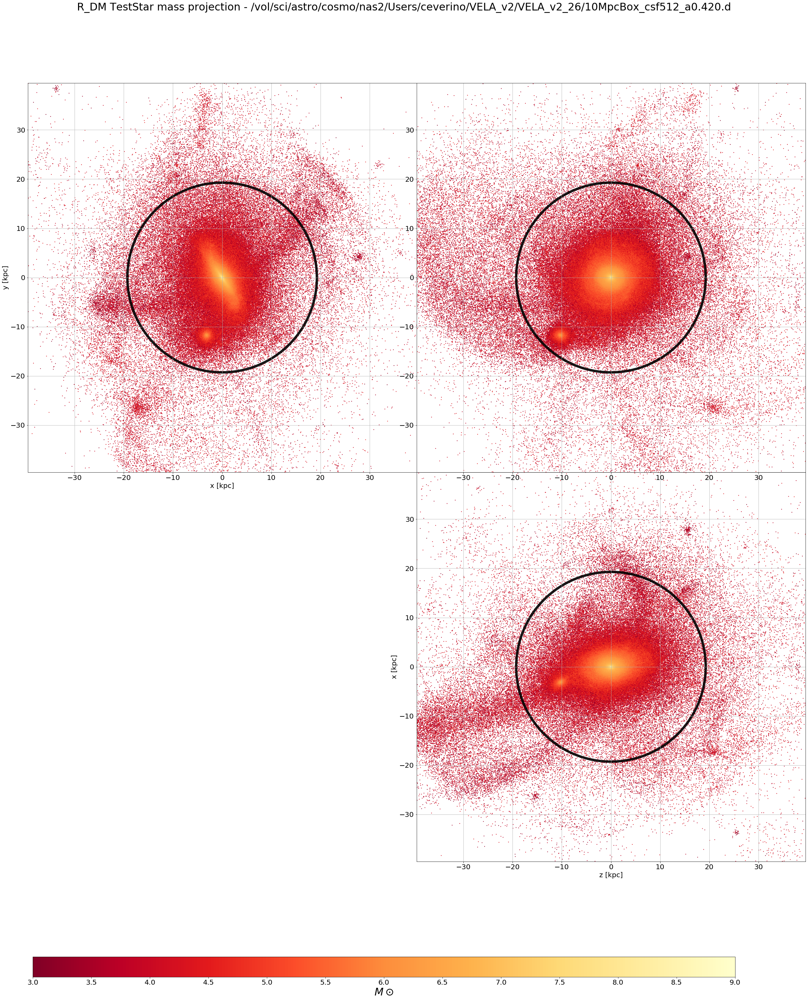

alive @ plot_projection


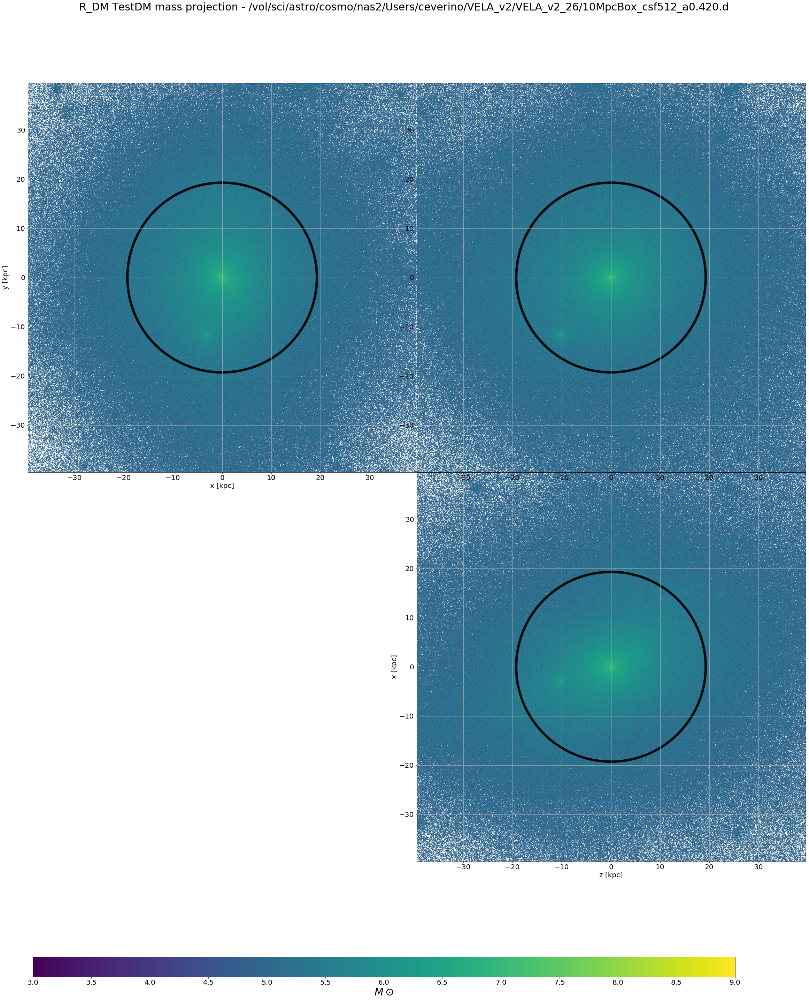

alive @ plot_projection


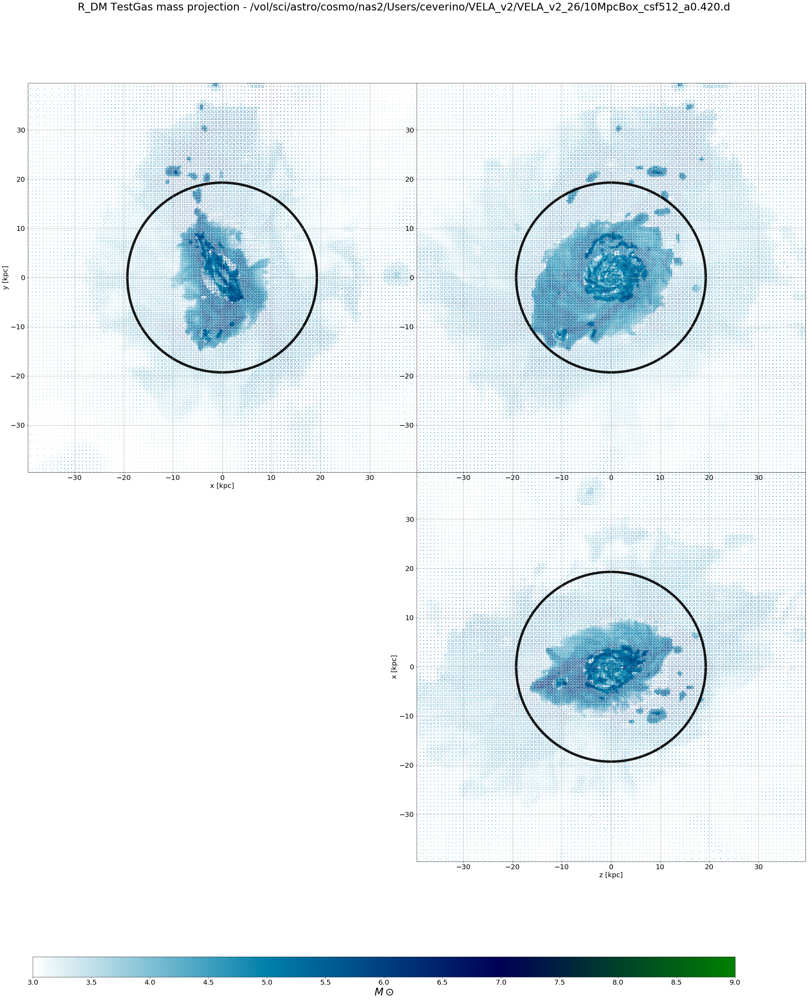

In [352]:
reload (bp)
bp.plot_galaxies('R_DM Test',sim_cat.loc[sgal_lines['sim_id'][0]]['sim_path'].replace('from_nas2','Users'), sgal_lines, max(plot_range+1,5), 0, center=sp.center,ds=ds, sgal_rs=[float(r_dm),float(r_dm_half)])

In [288]:
len(sgal_R_df)

27673

In [338]:
def get_mass_binned_DM(sp, min_bin_dis = 0.025):
    sp_r = sp.radius.in_units('kpc').v
    stars_r = sp[('darkmatter', 'particle_position_spherical_radius')].in_units('kpc').v
    stars_mass = sp[('darkmatter', 'particle_mass')].in_units('Msun').v
#     #cumsum
#     stars_r_argsorted = np.argsort(stars_r)
#     stars_mass_sorted = stars_mass[stars_r_argsorted]
#     stars_r_sorted    = stars_r[stars_r_argsorted]
#     stars_mass_cumsum = np.cumsum(stars_mass_sorted)
    # Binning (min_bin_dis pc bin)
    hist_bins = int(sp_r/min_bin_dis)
    hist_range = (0, sp_r) #was 100
    star_mass_binned, star_r_bin_edges = np.histogram(stars_r, bins=hist_bins,normed=False, range=hist_range, weights=stars_mass)
    stars_mass_binned_cumsum = np.cumsum(star_mass_binned)
    star_r_binning = 0.5*(star_r_bin_edges[1:]+star_r_bin_edges[:-1])
    yk = stars_mass_binned_cumsum
    xk = star_r_binning

#   star_volume = (4*np.pi/3) * (star_r_bin_edges[1:]**3 - star_r_bin_edges[:-1]**3)
#   star_density = np.divide(star_mass_binned, star_volume)
    return (xk,yk)
    

In [297]:
min_bin_dis

0.025

In [353]:
stars_r = sp[('darkmatter', 'particle_position_spherical_radius')].in_units('kpc').v
stars_mass = sp[('darkmatter', 'particle_mass')].in_units('Msun').v

stars_r_argsorted = np.argsort(stars_r);        stars_mass_sorted = stars_mass[stars_r_argsorted]
stars_r_sorted    = stars_r[stars_r_argsorted]; stars_mass_cumsum = np.cumsum(stars_mass_sorted)

In [354]:
sgal_R_df.loc[sgid]['sim_id']
sgal_lines['sim_id'][0]

'VELA_v2.Thick.26.a0.420061826706'

VELA_v2.Thick.26.a0.420061826706_00001


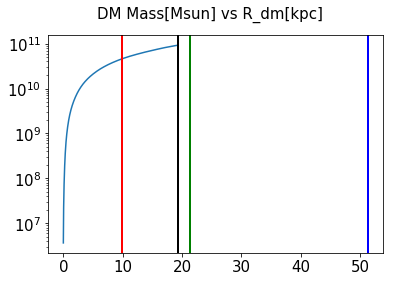

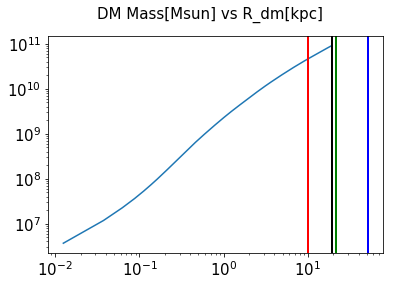

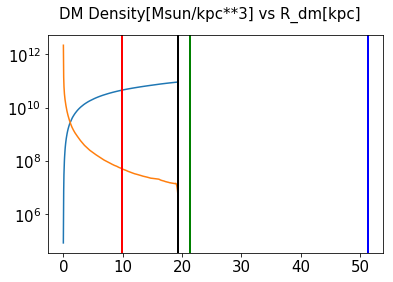

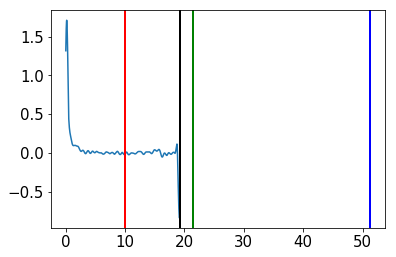

In [355]:
from scipy.interpolate import spline, interp1d, UnivariateSpline
from scipy.signal import savgol_filter, resample_poly, find_peaks_cwt

import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm

min_bin_dis = 0.025

cen_r = 0.1*cen_gal_cat.loc[sgal_lines['sim_id'][0]]['r_vir[kpc]']
xk, yk = get_mass_binned_DM(sp, min_bin_dis)

# --- Fitting Func's: ------------------------------>
#
sv_w, sv_p = 41, 4
sg_fit_d0 = savgol_filter(yk, window_length=sv_w, polyorder=sv_p, deriv=0, mode='nearest', delta=min_bin_dis) #*10.0**-3
sg_fit_logM_d1 = savgol_filter(np.log10(yk), window_length=sv_w, polyorder=sv_p, deriv=1, \
                               mode='nearest', delta=min_bin_dis)# *10.0**-3
sg_fit_d1 = savgol_filter(yk, window_length=sv_w, polyorder=sv_p, \
                        deriv=1, mode='nearest', delta=min_bin_dis) # *10.0**-3
sg_fit_log_rho_d2 = savgol_filter(np.log10((sg_fit_d1[1:])/(np.diff(xk)**2)), window_length=sv_w, polyorder=3, \
                        deriv=1, mode='nearest', delta=min_bin_dis) # *10.0**-3


#us_f_d1 = UnivariateSpline(xk, yk, k=2, s=1).derivative()

# --- Plots: --------------------------------------->
#
print sgid

matplotlib.rcParams.update({'font.size': 15})
# Mass Profile
plt.suptitle('DM Mass[Msun] vs R_dm[kpc]', fontsize=15)
#plt.semilogy(xk, yk)
plt.semilogy(xk, sg_fit_d0)
plt.axvline(x=r_dm, linewidth=2, color = 'k')
plt.axvline(x=r_dm_half, linewidth=2, color = 'red')
plt.axvline(x=r_1min, linewidth=2, color = 'green')
plt.axvline(x=r_der, linewidth=2, color = 'b')
#plt.axvline(x=cen_r, linewidth=2, color = 'grey')
# plt.axvline(x=r_1min_by_der, linewidth=2, color = 'k')
# plt.axvline(x=r_by_der_log_mass, linewidth=2, color = 'b')
# plt.axvline(x=r_by_mass_bin, linewidth=2, color = 'cyan')
#plt.axvline(x=sgal_r_eff, linewidth=2, color = 'r')
plt.show()

plt.suptitle('DM Mass[Msun] vs R_dm[kpc]', fontsize=15)
plt.loglog(xk, sg_fit_d0)
#plt.plot(np.log10(xk), np.log10(sg_fit_d0))
plt.axvline(x=r_dm, linewidth=2, color = 'k')
plt.axvline(x=r_dm_half, linewidth=2, color = 'red')
plt.axvline(x=r_1min, linewidth=2, color = 'green')
plt.axvline(x=r_der, linewidth=2, color = 'b')
#plt.axvline(x=cen_r, linewidth=2, color = 'grey')
plt.show()
# # (log(M) )'
# plt.semilogy(xk, sg_fit_logM_d1)
# plt.axhline(y=per_thresh-1, linewidth=2, color = 'k')
# plt.show()

# Density Profile
plt.suptitle('DM Density[Msun/kpc**3] vs R_dm[kpc]', fontsize=15)
plt.semilogy(stars_r_sorted, stars_mass_cumsum)
n = 0
plt.plot(xk[n:], (sg_fit_d1[n:])/xk[n:]**2)
plt.axvline(x=r_dm, linewidth=2, color = 'k')
plt.axvline(x=r_dm_half, linewidth=2, color = 'red')
plt.axvline(x=r_1min, linewidth=2, color = 'green')
plt.axvline(x=r_der, linewidth=2, color = 'b')
#plt.axvline(x=cen_r, linewidth=2, color = 'grey')
plt.show()

        
plt.plot(xk[n+1:], sg_fit_log_rho_d2[n:])
plt.axvline(x=r_dm, linewidth=2, color = 'k')
plt.axvline(x=r_dm_half, linewidth=2, color = 'red')
plt.axvline(x=r_1min, linewidth=2, color = 'green')
plt.axvline(x=r_der, linewidth=2, color = 'b')
#plt.axvline(x=cen_r, linewidth=2, color = 'grey')
plt.show()
#plt.axhline(y=0, linewidth=2, color = 'k')
# plt.axvline(x=sgal_r_eff, linewidth=2, color = 'r')
# plt.axvline(x=r_1min_by_der, linewidth=2, color = 'k')
# peakind = find_peaks_cwt(np.log10(sg_fit_d1), np.arange(1,100))
# peakind[0], xk[peakind[0]]
# f_poly = resample_poly(yk, 2, 50, xk) #does not aplly to different spaces between particles ...
# f = interp1d(xk, yk, kind=3, assume_sorted=True)
# spline(xk, yk, xnew, order=3, kind='smoothest', conds=None) # Too Heavy
# spl = UnivariateSpline(xk, yk) # Too heavy


In [356]:
print r_dm,r_dm_half,r_1min,r_der

19.2753955195 9.94696741172 21.3810808307 51.2647883068


In [357]:
print sgal_lines.index[0]

VELA_v2.Thick.26.a0.420061826706_00001


In [324]:
pd.set_option('display.max_rows', 100000)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 10)

In [330]:
sgal_R_df.iloc[10000]

zana_r                                      10.414
zana_z                                    0.513294
zana_y                                    0.515173
zana_x                                    0.493236
zana_n_stars                               1339232
galaxynumber                                    10
sim_id            VELA_v2.Thick.10.a0.510838806629
gen                                        VELA_v2
zana_mass                                 1.92e+10
zana_gid                                         2
snap_index                                  a0.510
type                                         Thick
aexp                                      0.510839
x(kpc)                               14397.9482239
y(kpc)                                15038.306572
z(kpc)                               14983.4570786
Rcen                                        334.91
rho_th                                           0
Rth                                          34.95
Rsb                            

In [ ]:
import Galaxy_plot as gp
reload(gp)


In [ ]:
sp_r = sp.radius.in_units('kpc').v
hist_bins = int(sp_r/min_bin_dis) # was 1000

In [ ]:
hist_bins

In [ ]:
sgal_lines['sim_id'][0]

In [ ]:
gp.plot_density_profile(sp=sp, bin_num=hist_bins, gal_details=sgal_lines['sim_id'][0], radiuses=[r_dm,r_dm_half], radiuses_labels=['R_dm','R_dm_half'])

In [ ]:
gp.plot_mass_profile(sp=sp, bin_num=hist_bins, gal_details=str(sgal_lines['sim_id'][0]), radiuses=[r_dm], radiuses_labels=['R_dm'])